In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import math
import os
import yfinance as yf
import pandas_datareader as pdr
import datetime as dt
import tensorflow as tf
from tensorflow.keras import layers
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, StandardScaler
from sklearn.metrics import davies_bouldin_score, mean_absolute_error, mean_squared_error
from dtaidistance import dtw
import kmedoids

In [7]:
yf.pdr_override()
sp500 = pdr.get_data_yahoo('SPY', start='2016-01-04', end='2020-12-31')
sp500['return'] = np.log(sp500.Close/sp500.Close.shift(1))
sp500['cumreturn'] = sp500['return'].cumsum().apply(np.exp)
sp500.fillna(1, inplace=True)
sp500

,High,Low,Open,Close,Volume,Adj Close,return,cumreturn
Date,,,,,,,,
2016-01-04,201.029999,198.589996,200.490005,201.020004,222353500.0,178.051285,1.000000,1.000000
2016-01-05,201.899994,200.050003,201.399994,201.360001,110845800.0,178.352402,0.001690,1.001691
2016-01-06,200.059998,197.600006,198.339996,198.820007,152112600.0,176.102661,-0.012694,0.989056
2016-01-07,197.440002,193.589996,195.330002,194.050003,213436100.0,171.877686,-0.024284,0.965327
2016-01-08,195.850006,191.580002,195.190002,191.919998,209817200.0,169.991043,-0.011037,0.954731
...,...,...,...,...,...,...,...,...
2020-12-24,369.029999,367.450012,368.079987,369.000000,26457900.0,359.978088,0.003883,1.835638
2020-12-28,372.589996,371.070007,371.739990,372.170013,39000400.0,363.070618,0.008554,1.851408
2020-12-29,374.000000,370.829987,373.809998,371.459991,53680500.0,362.377960,-0.001910,1.847876


In [8]:
df = pd.read_csv(f"{os.path.dirname(os.getcwd())}\SP500 stock OHLC extended.csv", header=0, index_col=0, parse_dates=[0])
data = df.copy()
data = data.loc[data.index > '2004-08-11', ['Open', 'Close', 'symbol', 'industry']]
data

,Open,Close,symbol,industry
Date,,,,
2004-08-12,15.579399,14.077253,A,Health Care
2004-08-13,15.293276,14.678112,A,Health Care
2004-08-16,14.556509,14.821173,A,Health Care
2004-08-17,14.964235,15.157368,A,Health Care
2004-08-18,15.193133,15.572246,A,Health Care
...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials
2022-10-25,47.720001,51.509998,ZION,Financials
2022-10-26,51.040001,50.400002,ZION,Financials


In [9]:
lag = 100
indicators = ['Close_norm']
for i in range(1, lag):
    indicators.append(f'Close_norm_{i}')

In [5]:
# train_dic = {}
# val_dic = {}
# test_dic = {}

# standardizer = StandardScaler()
# normalizer = MinMaxScaler(feature_range=(-1,1))

# for ticker in data.symbol.unique():
#     temp = data.loc[data.symbol == ticker]
#     temp.loc[:, 'Close_norm'] = temp['Close']
#     for i in range(1, lag):
#         temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
#     tempT = temp.loc[:, indicators].transpose()
#     normT = normalizer.fit_transform(tempT)
#     temp.loc[:, indicators] = normT.transpose()
#     train = temp.loc[(temp.index >= '2005-01-01') & (temp.index < '2015-01-01')]
#     val = temp.loc[(temp.index >= '2015-01-01') & (temp.index < '2016-01-01')]
#     test = temp.loc[(temp.index >= '2016-01-01') & (temp.index < '2021-01-01')]
    
#     train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
#     train.loc[:, 'return'] = np.log(train['Close_stand']/train['Close_stand'].shift(1))
    
#     train.loc[:, 'Close_shifted'] = train.Close.shift(-6)
#     train.loc[:, 'Target'] = ((train['Close_shifted']-train['Open'])/train['Open']).shift(-1)
#     train_dic[ticker] = train
    
#     val.loc[:, 'Close_shifted'] = val.Close.shift(-6)
#     val.loc[:, 'Target'] = ((val['Close_shifted']-val['Open'])/val['Open']).shift(-1)
#     val_dic[ticker] = val
    
#     test.loc[:, 'Close_shifted'] = test.Close.shift(-6)
#     test.loc[:, 'Target'] = ((test['Close_shifted']-test['Open'])/test['Open']).shift(-1)
#     test_dic[ticker] = test

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, '

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\2764914102.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train.loc[:, 'Close_stand'] = standardizer.fit_transform(np.array(train['Close']).reshape(-1,1))
C:\Users\kmlee\anaconda3\lib\site-packages\pandas\core\arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufun

In [10]:
with open('train_dic.pkl', 'rb') as f:
    train_dic = pickle.load(f)

with open('val_dic.pkl', 'rb') as f:
    val_dic = pickle.load(f)

with open('test_dic.pkl', 'rb') as f:
    test_dic = pickle.load(f)

In [11]:
train_dic['A']

,Open,Close,symbol,industry,Close_norm,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,Close_norm_5,...,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_stand,return,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2005-01-03,17.238913,17.081545,A,Health Care,0.379311,0.451560,0.448276,0.543515,0.422004,0.353038,...,-0.300493,-0.313629,-0.504105,-0.658457,-0.724138,-1.000000,-1.209589,NaN,15.886981,-0.067283
2005-01-04,17.010014,16.630901,A,Health Care,0.098390,0.323793,0.402505,0.398927,0.502684,0.370305,...,-0.277281,-0.416816,-0.431127,-0.638640,-0.806798,-0.878354,-1.269406,0.048269,15.865522,-0.063012
2005-01-05,16.573677,16.623749,A,Health Care,0.094813,0.098390,0.323793,0.402505,0.398927,0.502684,...,-0.295170,-0.277281,-0.416816,-0.431127,-0.638640,-0.806798,-1.270355,0.000748,15.529328,-0.057692
2005-01-06,16.738197,16.258942,A,Health Care,-0.087656,0.094813,0.098390,0.323793,0.402505,0.398927,...,-0.488372,-0.295170,-0.277281,-0.416816,-0.431127,-0.638640,-1.318779,0.037410,15.772532,-0.011023
2005-01-07,16.223175,16.244635,A,Health Care,-0.094812,-0.087656,0.094813,0.098390,0.323793,0.402505,...,-0.363148,-0.488372,-0.295170,-0.277281,-0.416816,-0.431127,-1.320678,0.001439,16.044350,-0.026908
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-24,41.419998,41.130001,A,Health Care,0.440141,0.523597,0.700945,0.527075,0.290613,-0.036262,...,-0.345813,-0.131898,-0.121947,-0.169209,-0.034889,-0.121947,1.982539,-0.015941,NaN,NaN
2014-12-26,41.340000,41.380001,A,Health Care,0.527075,0.440141,0.523597,0.700945,0.527075,0.290613,...,-0.236369,-0.345813,-0.131898,-0.121947,-0.169209,-0.034889,2.015724,0.016600,NaN,NaN
2014-12-29,41.360001,41.330002,A,Health Care,0.509689,0.527075,0.440141,0.523597,0.700945,0.527075,...,-0.027426,-0.236369,-0.345813,-0.131898,-0.121947,-0.169209,2.009087,-0.003298,NaN,NaN


In [12]:
returns = pd.DataFrame()
for ticker in train_dic.keys():
    temp = train_dic[ticker]
    returns.loc[:, ticker] = temp.iloc[1:]['return']
returns

C:\Users\kmlee\AppData\Local\Temp\ipykernel_22468\2552685674.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  returns.loc[:, ticker] = temp.iloc[1:]['return']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_22468\2552685674.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  returns.loc[:, ticker] = temp.iloc[1:]['return']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_22468\2552685674.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performanc

C:\Users\kmlee\AppData\Local\Temp\ipykernel_22468\2552685674.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  returns.loc[:, ticker] = temp.iloc[1:]['return']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_22468\2552685674.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  returns.loc[:, ticker] = temp.iloc[1:]['return']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_22468\2552685674.py:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performanc

,A,AAP,AAPL,ABC,ABMD,ABT,ACGL,ACN,ADBE,ADI,...,WTW,WY,WYNN,XEL,XOM,XRAY,YUM,ZBH,ZBRA,ZION
Date,,,,,,,,,,,,,,,,,,,,,
2005-01-04,0.048269,0.006327,-0.001283,0.005820,0.134100,0.043406,0.009066,0.028257,0.107063,NaN,...,0.051316,-0.043845,0.003598,0.049279,0.012133,0.027278,0.013768,-0.002981,-0.067129,-0.033597
2005-01-05,0.000748,-0.001742,-0.001107,0.001387,0.794399,0.046788,0.003963,0.004484,0.020347,-0.202503,...,-0.120859,0.012111,-0.019168,0.034998,0.009180,0.038132,0.002423,-0.063683,-0.135648,-0.008953
2005-01-06,0.037410,0.000871,-0.000099,-0.006192,0.278636,-0.093031,0.000898,0.010237,0.058669,0.080820,...,-0.033649,0.011541,-0.072668,0.005145,-0.022390,-0.015079,-0.011506,0.092133,0.006098,0.014139
2005-01-07,0.001439,0.005427,-0.009336,0.002152,0.284439,-0.078745,-0.007030,-0.054135,-0.002305,-0.066886,...,-0.110574,0.043249,0.062416,0.016964,0.011791,0.024246,0.005770,-0.013634,0.033627,-0.061719
2005-01-10,0.007877,-0.003253,0.000579,0.000000,-0.150738,-0.048254,-0.003443,-0.016496,-0.002310,0.177047,...,-0.013582,0.011331,-0.006894,-0.041206,-0.006772,-0.072122,-0.000221,0.071871,0.052951,0.001571
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2014-12-24,-0.015941,-0.009485,-0.007409,0.003143,0.005609,-0.001097,-0.008383,-0.002306,0.009862,0.002449,...,-0.004238,-0.006260,-0.016842,0.064202,-0.049882,-0.013391,0.004080,0.014386,0.006458,0.000908
2014-12-26,0.016600,-0.002286,0.027401,-0.001570,0.007715,0.008197,-0.007747,-0.001386,-0.001910,-0.021265,...,-0.002126,-0.001572,-0.011460,0.026843,-0.036656,0.004484,0.012871,0.001338,-0.005940,-0.003635
2014-12-29,-0.003298,0.012065,-0.001093,0.002093,-0.006855,-0.013699,0.005991,-0.017255,-0.014859,-0.010047,...,-0.016091,-0.001573,0.055619,0.049457,-0.009213,-0.006170,0.015230,-0.015045,-0.001296,-0.014674


In [13]:
returnsT = returns.transpose().fillna(0)
returnsT

Date,2005-01-04,2005-01-05,2005-01-06,2005-01-07,2005-01-10,2005-01-11,2005-01-12,2005-01-13,2005-01-14,2005-01-18,...,2014-12-17,2014-12-18,2014-12-19,2014-12-22,2014-12-23,2014-12-24,2014-12-26,2014-12-29,2014-12-30,2014-12-31
A,0.048269,0.000748,0.037410,0.001439,0.007877,0.027439,0.002080,0.032031,-0.023068,-0.026428,...,0.099922,0.066997,0.045812,0.032395,-0.033054,-0.015941,0.016600,-0.003298,0.002639,-0.028744
AAP,0.006327,-0.001742,0.000871,0.005427,-0.003253,-0.005664,0.003489,0.001957,-0.005446,-0.024547,...,0.025713,0.011823,-0.008829,-0.004094,0.017358,-0.009485,-0.002286,0.012065,-0.011767,-0.007488
AAPL,-0.001283,-0.001107,-0.000099,-0.009336,0.000579,0.008738,-0.001781,-0.008634,-0.000799,-0.000900,...,0.039504,0.046100,-0.012172,0.016196,-0.005555,-0.007409,0.027401,-0.001093,-0.019179,-0.030265
ABC,0.005820,0.001387,-0.006192,0.002152,0.000000,-0.001772,-0.000253,0.012093,-0.002131,-0.008569,...,0.020268,0.012703,0.006988,0.004516,-0.009053,0.003143,-0.001570,0.002093,-0.006117,-0.019831
ABMD,0.134100,0.794399,0.278636,0.284439,-0.150738,0.128976,0.143240,0.970617,0.134927,0.055245,...,0.050564,0.006431,-0.016155,0.075699,-0.003024,0.005609,0.007715,-0.006855,-0.005172,-0.013049
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
XRAY,0.027278,0.038132,-0.015079,0.024246,-0.072122,0.000000,0.011580,0.035127,-0.031497,-0.015209,...,0.011086,0.051457,-0.022293,0.021742,-0.004976,-0.013391,0.004484,-0.006170,-0.022187,-0.004035
YUM,0.013768,0.002423,-0.011506,0.005770,-0.000221,-0.003325,0.010382,0.014400,0.004323,-0.007143,...,0.065753,0.044893,-0.022194,0.049543,0.008210,0.004080,0.012871,0.015230,-0.010127,-0.015755
ZBH,-0.002981,-0.063683,0.092133,-0.013634,0.071871,-0.031516,-0.021897,-0.279086,0.186363,0.190751,...,0.076278,0.068462,-0.000657,0.003065,-0.035147,0.014386,0.001338,-0.015045,0.023920,-0.025732
ZBRA,-0.067129,-0.135648,0.006098,0.033627,0.052951,-0.163975,-0.064438,0.013051,0.012029,0.100666,...,0.032410,0.047116,0.003893,0.006454,-0.006972,0.006458,-0.005940,-0.001296,0.006978,-0.023715


In [13]:
# dtw_mat = dtw.distance_matrix_fast(returnsT.to_numpy(), parallel=True)
# pd.DataFrame(dtw_mat).to_csv('distance_matrix.csv', header=None, index=None)

DTAIDistance C-extension for Numpy is not available. Proceeding anyway.


In [14]:
dtw_mat = pd.read_csv('distance_matrix.csv', header=None).to_numpy()
dtw_mat

array([[ 0.        , 16.62580732, 19.85727974, ..., 17.40707709,
        15.79044763, 18.01155316],
       [16.62580732,  0.        ,  7.74149778, ..., 11.86749211,
        11.55377641,  7.04098985],
       [19.85727974,  7.74149778,  0.        , ..., 12.38812152,
        12.72460151,  5.64195973],
       ...,
       [17.40707709, 11.86749211, 12.38812152, ...,  0.        ,
        12.24616086, 11.55693341],
       [15.79044763, 11.55377641, 12.72460151, ..., 12.24616086,
         0.        , 11.88378254],
       [18.01155316,  7.04098985,  5.64195973, ..., 11.55693341,
        11.88378254,  0.        ]])

,Difference in SS
2,NaN
3,-50.251280
4,-40.622820
5,-27.620400
6,-22.685181
7,-29.652264
8,-14.635379
9,-18.816484
10,-20.279763
11,-17.264026


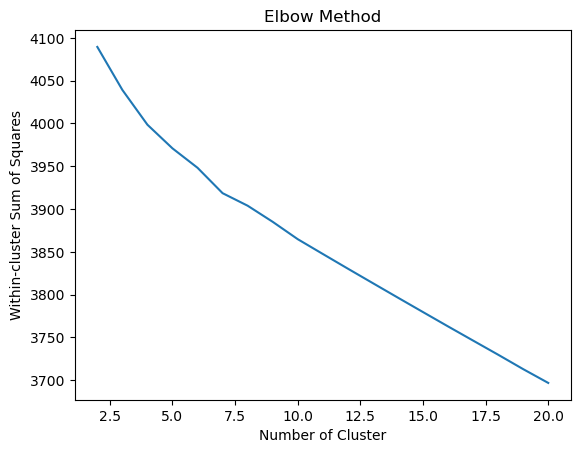

In [15]:
kmax = 20
ssq_list = []
for k in range(2, kmax+1):
    ssq = kmedoids.KMedoids(n_clusters=k,
                           random_state=0).fit(dtw_mat).inertia_
    ssq_list.append(ssq)
    
plt.plot(range(2, kmax+1), ssq_list)
plt.title("Elbow Method") 
plt.xlabel("Number of Cluster") 
plt.ylabel("Within-cluster Sum of Squares")

pd.DataFrame(ssq_list, columns = ['Difference in SS'], index = range(2,kmax+1)).diff()

,score
2,0.779493
3,1.032499
4,1.092159
5,2.199157
6,4.466801
7,3.487012
8,4.074248
9,4.312495
10,3.344009
11,2.940582


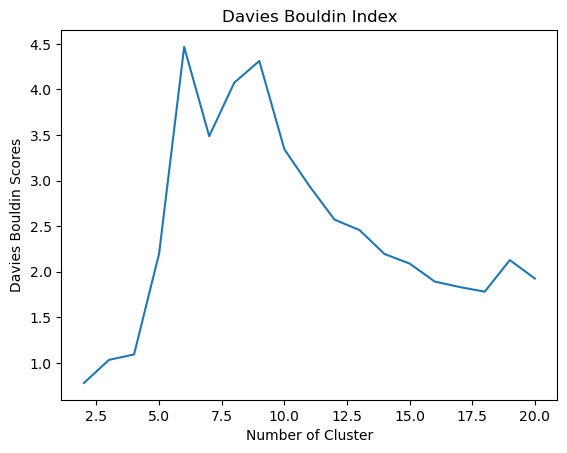

In [16]:
# Davies Bouldin score
db_scores = []
for k in range(2, kmax+1):
    score = kmedoids.KMedoids(n_clusters=k,
                              random_state=0).fit(dtw_mat).labels_
    db_scores.append(davies_bouldin_score(dtw_mat, score))
    
plt.plot(range(2, kmax+1), db_scores)
plt.title("Davies Bouldin Index") 
plt.xlabel("Number of Cluster") 
plt.ylabel("Davies Bouldin Scores")

pd.DataFrame(db_scores, columns=['score'], index=range(2,kmax+1))

In [17]:
# Get 4 clusters
num_clusters = 4
clusters_pred = kmedoids.KMedoids(n_clusters=num_clusters,
                                 random_state=0).fit_predict(dtw_mat)
clusters_pred_df = pd.DataFrame({'symbol': returns.columns,
                                 'cluster': clusters_pred})
clusters_pred_df

,symbol,cluster
0,A,0
1,AAP,1
2,AAPL,3
3,ABC,3
4,ABMD,2
...,...,...
388,XRAY,0
389,YUM,3
390,ZBH,2
391,ZBRA,2


In [18]:
# Prepare dataset for feeding into NN model
def get_dataset(cluster, dic, train_val_data=True):
    symbols = clusters_pred_df.loc[clusters_pred_df['cluster']==cluster, 'symbol'].unique()
    df_list = []
    for ticker in symbols:
        temp = dic[ticker]
        temp = temp.iloc[:-7, :] if train_val_data else temp 
        temp = temp.loc[:, ['symbol'] + indicators + ['Open', 'Close_shifted', 'Target']]
        df_list.append(temp)
    df = pd.concat(df_list)
    x, y = df.loc[:, indicators].to_numpy(), df.loc[:, 'Target'].to_numpy()
    return x, y

In [19]:
def create_early_stopping():
    return tf.keras.callbacks.EarlyStopping(monitor='val_mae',
                                           patience=3)

In [20]:
def plot_history(histories):
    fig, ax = plt.subplots(num_clusters, 2, figsize=(150,150))
    fig.tight_layout()
    metrics = ['mae', 'loss']
    for i in range(num_clusters):
        history = histories[i]
        for j in range(2):
            metric = metrics[j]
            ax[i,j].plot(history.history[f'{metric}'])
            ax[i,j].plot(history.history[f'val_{metric}'])
            ax[i,j].legend([f'train {metric}', f'val {metric}'], loc='upper left')
            ax[i,j].set_title(f'cluster_{i}')
            ax[i,j].figure.set_size_inches(30,30)

In [84]:
# # Train LSTM models for each cluster

# histories = []
# for i in range(num_clusters):
#     train_x, train_y = get_dataset(i, train_dic)
#     val_x, val_y = get_dataset(i, val_dic)
    
#     tf.random.set_seed(0)
#     inputs = layers.Input(shape=(100,), dtype=tf.float32)
#     x = layers.Lambda(lambda x: tf.expand_dims(x, axis=1))(inputs)
#     x = layers.LSTM(128, activation='relu')(x)
#     x = layers.Dropout(0.2)(x)
#     output = layers.Dense(1)(x)
    
#     model = tf.keras.Model(inputs, output)
#     model.compile(loss='mae',
#                  optimizer='Adam',
#                  metrics=['mae', 'mse'])
    
#     history = model.fit(train_x,
#              train_y,
#              epochs=15,
#              validation_data=(val_x, val_y),
#              callbacks = [create_early_stopping()])
    
#     histories.append(history)
#     file_loc = f'{os.getcwd()}\cluster_{i}_pretrained_model'
#     tf.keras.models.save_model(model, file_loc)

Epoch 1/15
7295/7295 [==============================] - 45s 6ms/step - loss: 0.0367 - mae: 0.0367 - mse: 0.0028 - val_loss: 0.0293 - val_mae: 0.0293 - val_mse: 0.0017
Epoch 2/15
7295/7295 [==============================] - 42s 6ms/step - loss: 0.0361 - mae: 0.0361 - mse: 0.0027 - val_loss: 0.0292 - val_mae: 0.0292 - val_mse: 0.0017
Epoch 3/15
7295/7295 [==============================] - 41s 6ms/step - loss: 0.0360 - mae: 0.0360 - mse: 0.0027 - val_loss: 0.0302 - val_mae: 0.0302 - val_mse: 0.0018
Epoch 4/15
7295/7295 [==============================] - 41s 6ms/step - loss: 0.0359 - mae: 0.0359 - mse: 0.0027 - val_loss: 0.0299 - val_mae: 0.0299 - val_mse: 0.0017
Epoch 5/15
7295/7295 [==============================] - 40s 6ms/step - loss: 0.0358 - mae: 0.0358 - mse: 0.0027 - val_loss: 0.0296 - val_mae: 0.0296 - val_mse: 0.0017
INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\LWDTW_LSTM_strategy\cluster_0_pretrained_model\assets
Epoch 1/15
7766/7766 [==========

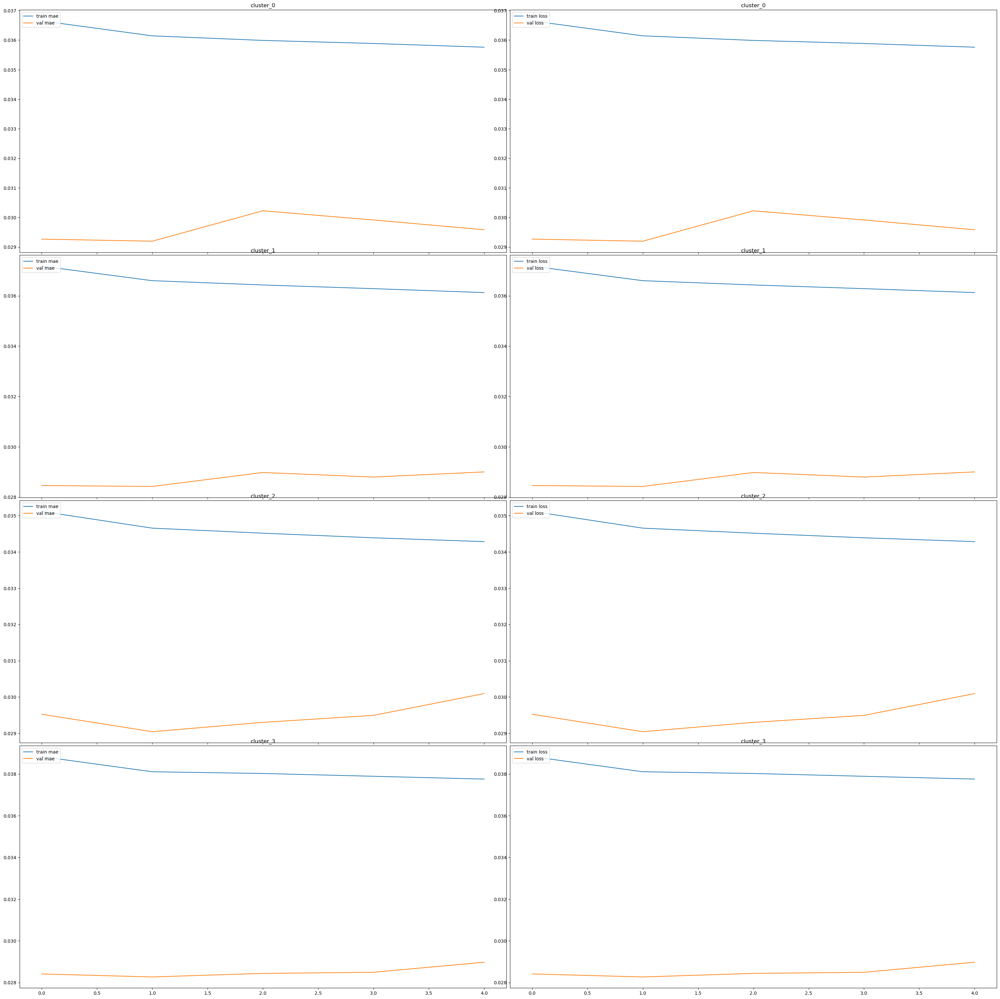

In [85]:
# plot_history(histories)

In [16]:
# fulltrain_dic = {}

# normalizer = MinMaxScaler(feature_range=(-1,1))

# for ticker in data.symbol.unique():
#     temp= data.loc[data.symbol == ticker]
#     temp.loc[:, 'Close_norm'] = temp['Close']
#     for i in range(1, lag):
#         temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
#     tempT = temp.loc[:, indicators].transpose()
#     normT = normalizer.fit_transform(tempT)
#     temp.loc[:, indicators] = normT.transpose()
#     fulltrain = temp.loc[(temp.index >= '2005-01-01') & (temp.index < '2016-01-01')]
    
#     fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
#     fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
#     fulltrain_dic[ticker] = fulltrain

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be s

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be s

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be s

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be s

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be s

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Target'] = ((fulltrain['Close_shifted']-fulltrain['Open'])/fulltrain['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:7: SettingWithCopyWarning: 
A value is trying to be set on

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be s

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fu

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fulltrain.loc[:, 'Close_shifted'] = fulltrain.Close.shift(-6)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_8520\118836123.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

In [21]:
with open('fulltrain_dic.pkl', 'rb') as f:
    fulltrain_dic = pickle.load(f)

In [22]:
fulltrain_dic['A']

,Open,Close,symbol,industry,Close_norm,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,Close_norm_5,...,Close_norm_92,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2005-01-03,17.238913,17.081545,A,Health Care,0.379311,0.451560,0.448276,0.543515,0.422004,0.353038,...,-0.188834,-0.172414,-0.300493,-0.313629,-0.504105,-0.658457,-0.724138,-1.000000,15.886981,-0.067283
2005-01-04,17.010014,16.630901,A,Health Care,0.098390,0.323793,0.402505,0.398927,0.502684,0.370305,...,-0.488372,-0.295170,-0.277281,-0.416816,-0.431127,-0.638640,-0.806798,-0.878354,15.865522,-0.063012
2005-01-05,16.573677,16.623749,A,Health Care,0.094813,0.098390,0.323793,0.402505,0.398927,0.502684,...,-0.363148,-0.488372,-0.295170,-0.277281,-0.416816,-0.431127,-0.638640,-0.806798,15.529328,-0.057692
2005-01-06,16.738197,16.258942,A,Health Care,-0.087656,0.094813,0.098390,0.323793,0.402505,0.398927,...,-0.499105,-0.363148,-0.488372,-0.295170,-0.277281,-0.416816,-0.431127,-0.638640,15.772532,-0.011023
2005-01-07,16.223175,16.244635,A,Health Care,-0.094812,-0.087656,0.094813,0.098390,0.323793,0.402505,...,-0.477639,-0.499105,-0.363148,-0.488372,-0.295170,-0.277281,-0.416816,-0.431127,16.044350,-0.026908
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-24,41.790001,42.139999,A,Health Care,1.000000,0.915622,0.790194,0.701255,0.534777,0.689852,...,0.204105,0.183581,0.258837,0.379703,0.619157,0.509693,0.539339,0.676169,NaN,NaN
2015-12-28,42.020000,41.779999,A,Health Care,0.917902,1.000000,0.915622,0.790194,0.701255,0.534777,...,0.242874,0.204105,0.183581,0.258837,0.379703,0.619157,0.509693,0.539339,NaN,NaN
2015-12-29,42.080002,42.360001,A,Health Care,1.000000,0.870967,0.951056,0.868743,0.746385,0.659622,...,0.256952,0.212458,0.174639,0.154617,0.228031,0.345940,0.579533,0.472748,NaN,NaN


In [88]:
# val_histories = []
# for i in range(num_clusters):
#     fulltrain_x, fulltrain_y = get_dataset(i, fulltrain_dic)
    
#     tf.random.set_seed(0)
#     inputs = layers.Input(shape=(100,), dtype=tf.float32)
#     x = layers.Lambda(lambda x: tf.expand_dims(x, axis=1))(inputs)
#     x = layers.LSTM(128, activation='relu')(x)
#     x = layers.Dropout(0.2)(x)
#     output = layers.Dense(1)(x)
    
#     model = tf.keras.Model(inputs, output)
#     model.compile(loss='mae',
#                  optimizer='Adam',
#                  metrics=['mae', 'mse'])
    
#     history = model.fit(fulltrain_x,
#              fulltrain_y,
#              epochs=5)
    
#     val_histories.append(history)
#     file_loc = f'{os.getcwd()}\cluster_{i}_validated_model'
#     tf.keras.models.save_model(model, file_loc)

Epoch 1/5
8028/8028 [==============================] - 48s 6ms/step - loss: 0.0361 - mae: 0.0361 - mse: 0.0027
Epoch 2/5
8028/8028 [==============================] - 47s 6ms/step - loss: 0.0355 - mae: 0.0355 - mse: 0.0027
Epoch 3/5
8028/8028 [==============================] - 45s 6ms/step - loss: 0.0354 - mae: 0.0354 - mse: 0.0026
Epoch 4/5
8028/8028 [==============================] - 47s 6ms/step - loss: 0.0353 - mae: 0.0353 - mse: 0.0026
Epoch 5/5
8028/8028 [==============================] - 45s 6ms/step - loss: 0.0352 - mae: 0.0352 - mse: 0.0026
INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\LWDTW_LSTM_strategy\cluster_0_validated_model\assets
Epoch 1/5
8545/8545 [==============================] - 52s 6ms/step - loss: 0.0363 - mae: 0.0363 - mse: 0.0030
Epoch 2/5
8545/8545 [==============================] - 49s 6ms/step - loss: 0.0358 - mae: 0.0358 - mse: 0.0030
Epoch 3/5
8545/8545 [==============================] - 47s 6ms/step - loss: 0.0357 - mae: 0

In [23]:
test_list = []
for ticker in test_dic.keys():
    temp = test_dic[ticker]
    test_list.append(temp)
test_df = pd.concat(test_list)
test_df

,Open,Close,symbol,industry,Close_norm,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,Close_norm_5,...,Close_norm_92,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.628476,0.877642,0.957730,1.000000,0.870967,0.951056,...,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,0.228031,38.189999,-0.095016
2016-01-05,40.730000,40.549999,A,Health Care,0.597330,0.628476,0.877642,0.957730,1.000000,0.870967,...,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,36.860001,-0.065358
2016-01-06,40.240002,40.730000,A,Health Care,0.637375,0.597330,0.628476,0.877642,0.957730,1.000000,...,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,37.610001,-0.075486
2016-01-07,40.139999,39.000000,A,Health Care,0.252503,0.637375,0.597330,0.628476,0.877642,0.957730,...,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,37.110001,-0.051504
2016-01-08,39.220001,38.590000,A,Health Care,0.161290,0.252503,0.637375,0.597330,0.628476,0.877642,...,-0.272525,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,37.200001,-0.037458
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-24,43.619999,43.340000,ZION,Financials,0.913924,0.935443,0.749367,0.798734,0.627848,0.727848,...,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,-0.386076,NaN,NaN
2020-12-28,43.660000,43.360001,ZION,Financials,0.916456,0.913924,0.935443,0.749367,0.798734,0.627848,...,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,NaN,NaN
2020-12-29,43.389999,42.770000,ZION,Financials,0.841772,0.916456,0.913924,0.935443,0.749367,0.798734,...,-0.427848,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,NaN,NaN


In [24]:
test_df_clustered = clusters_pred_df.merge(test_df, on='symbol', how='left').set_index(test_df.index)
test_df_clustered

,symbol,cluster,Open,Close,industry,Close_norm,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_92,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,A,0,41.060001,40.689999,Health Care,0.628476,0.877642,0.957730,1.000000,0.870967,...,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,0.228031,38.189999,-0.095016
2016-01-05,A,0,40.730000,40.549999,Health Care,0.597330,0.628476,0.877642,0.957730,1.000000,...,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,0.154617,36.860001,-0.065358
2016-01-06,A,0,40.240002,40.730000,Health Care,0.637375,0.597330,0.628476,0.877642,0.957730,...,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,0.174639,37.610001,-0.075486
2016-01-07,A,0,40.139999,39.000000,Health Care,0.252503,0.637375,0.597330,0.628476,0.877642,...,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,0.212458,37.110001,-0.051504
2016-01-08,A,0,39.220001,38.590000,Health Care,0.161290,0.252503,0.637375,0.597330,0.628476,...,-0.272525,-0.499444,-0.779755,-0.708565,-0.363737,-0.078977,0.119022,0.256952,37.200001,-0.037458
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-12-24,ZION,3,43.619999,43.340000,Financials,0.913924,0.935443,0.749367,0.798734,0.627848,...,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,-0.386076,NaN,NaN
2020-12-28,ZION,3,43.660000,43.360001,Financials,0.916456,0.913924,0.935443,0.749367,0.798734,...,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,-0.449367,NaN,NaN
2020-12-29,ZION,3,43.389999,42.770000,Financials,0.841772,0.916456,0.913924,0.935443,0.749367,...,-0.427848,-0.283544,-0.206329,-0.235443,-0.181013,-0.092405,-0.179747,-0.294937,NaN,NaN


In [21]:
# # Make predictions on test data

# period = 7
# port_size = 20
# preds = []

# for i in range(len(test_df_clustered.index.unique())):
#     test_date = test_df_clustered.loc[test_df_clustered.index==test_df_clustered.index.unique()[i], :].copy()
#     curr_day = []
#     index = list(map(lambda x: x, test_df_clustered.index.unique())).index(test_df_clustered.index.unique()[i])
#     for j in range(num_clusters):
#         tf.keras.backend.clear_session()
#         test_date_cluster = test_date.loc[test_date['cluster']==j, :].copy()
#         model = tf.keras.models.load_model(f'{os.getcwd()}\cluster_{j}_validated_model')
#         test_x = tf.convert_to_tensor(test_date_cluster.loc[:, indicators].fillna(0).to_numpy())
#         if index%period == 0:
#             curr_day.append(pd.DataFrame({'Date': test_date_cluster.index,
#                                           'symbol': test_date_cluster.symbol,
#                                           'prediction': model.predict(test_x)[:, 0]}))
#         else:
#             curr_day.append(pd.DataFrame({'Date': test_date_cluster.index,
#                                           'symbol': test_date_cluster.symbol,
#                                           'prediction': [0]*len(test_date_cluster.index)}))
#     curr_day_pred = pd.concat(curr_day)
#     # Top 20 companies with highest chance to go long
#     top_df = curr_day_pred.sort_values(by=['prediction'], ascending=False).head(port_size)
#     if index%period==0:
#         curr_day_pred['position'] = np.where(curr_day_pred['symbol'].isin(top_df['symbol']),1, 0)
#     else:
#         curr_day_pred['position'] = np.array([0]*len(curr_day_pred))
#     preds.append(curr_day_pred)
# preds

2/2 [==============================] - 0s 9ms/step


[                 Date symbol  prediction  position
 Date                                              
 2020-01-02 2020-01-02      A           0         0
 2020-01-02 2020-01-02    ABT           0         0
 2020-01-02 2020-01-02   ADBE           0         0
 2020-01-02 2020-01-02    ADI           0         0
 2020-01-02 2020-01-02    ADM           0         0
 ...               ...    ...         ...       ...
 2020-01-02 2020-01-02    TYL           0         0
 2020-01-02 2020-01-02    VFC           0         0
 2020-01-02 2020-01-02    WEC           0         0
 2020-01-02 2020-01-02    YUM           0         0
 2020-01-02 2020-01-02   ZION           0         0
 
 [393 rows x 4 columns],
                  Date symbol  prediction  position
 Date                                              
 2020-01-03 2020-01-03      A           0         0
 2020-01-03 2020-01-03    ABT           0         0
 2020-01-03 2020-01-03   ADBE           0         0
 2020-01-03 2020-01-03    ADI        

In [25]:
preds_list = []
for i in range(2016, 2021):
    file = f'{i}_preds.csv'
    temp = pd.read_csv(file, header=0, index_col=0)
    preds_list.append(temp)
preds_df = pd.concat(preds_list).drop(['Date'], axis=1)
preds_df

,symbol,prediction,position,Date.1
2016-01-04,A,0.003803,0,NaN
2016-01-04,ABT,0.010270,0,NaN
2016-01-04,ADBE,0.005275,0,NaN
2016-01-04,ADI,0.010315,0,NaN
2016-01-04,ADM,0.002530,0,NaN
...,...,...,...,...
2020-12-31,TYL,0.000000,0,2020-12-31
2020-12-31,VFC,0.000000,0,2020-12-31
2020-12-31,WEC,0.000000,0,2020-12-31
2020-12-31,YUM,0.000000,0,2020-12-31


In [26]:
preds_df = preds_df.loc[:, ['symbol', 'prediction', 'position']]
preds_df.index.names = ['Date']
preds_df.sort_values(['symbol', 'Date'], inplace=True)
preds_df

,symbol,prediction,position
Date,,,
2016-01-04,A,0.003803,0
2016-01-05,A,0.000000,0
2016-01-06,A,0.000000,0
2016-01-07,A,0.000000,0
2016-01-08,A,0.000000,0
...,...,...,...
2020-12-24,ZION,0.000000,0
2020-12-28,ZION,0.000000,0
2020-12-29,ZION,0.000000,0


In [29]:
def get_pnl(x):
    if x['position'].sum() > 0:
        return ((x['Target'])*x['position']).sum()/port_size + 1
    return 1

In [30]:
def merge_preds(original_df, preds_df):
    merged_preds_df = original_df.sort_values(['symbol', 'Date'])
    merged_preds_df = pd.concat([merged_preds_df.loc[:, ['symbol', 'cluster', 'Close_shifted', 'Target']].reset_index(drop=True), preds_df.iloc[:, 1:].reset_index(drop=True)], axis=1)
    merged_preds_df.set_index(original_df.index, inplace=True)
    return merged_preds_df

In [31]:
def strategy_return(merged_preds_df):
    strategies = pd.DataFrame()
    strategies['avg return'] = merged_preds_df.groupby('Date').apply(get_pnl).shift(7).fillna(1)
    strategies['strategy'] = np.log(strategies['avg return'])
    strategies['cumstrategy'] = strategies['strategy'].cumsum().apply(np.exp)
    return strategies

In [32]:
test_preds = merge_preds(test_df_clustered, preds_df)
test_preds

,symbol,cluster,Close_shifted,Target,prediction,position
Date,,,,,,
2016-01-04,A,0,38.189999,-0.095016,0.003803,0
2016-01-05,A,0,36.860001,-0.065358,0.000000,0
2016-01-06,A,0,37.610001,-0.075486,0.000000,0
2016-01-07,A,0,37.110001,-0.051504,0.000000,0
2016-01-08,A,0,37.200001,-0.037458,0.000000,0
...,...,...,...,...,...,...
2020-12-24,ZION,3,NaN,NaN,0.000000,0
2020-12-28,ZION,3,NaN,NaN,0.000000,0
2020-12-29,ZION,3,NaN,NaN,0.000000,0


In [51]:
mae_df = test_preds.groupby('symbol').apply(lambda x: mean_absolute_error(x['Target'].dropna(), x.iloc[:-7, :]['prediction']))
rmse_df = test_preds.groupby('symbol').apply(lambda x: np.sqrt(mean_squared_error(x['Target'].dropna(), x.iloc[:-7, :]['prediction'])))
mae_df.mean(), rmse_df.mean()

(0.03410761722978225, 0.049113861866974626)

Text(0.5, 1.0, 'Top 10 highest tickers RMSE')

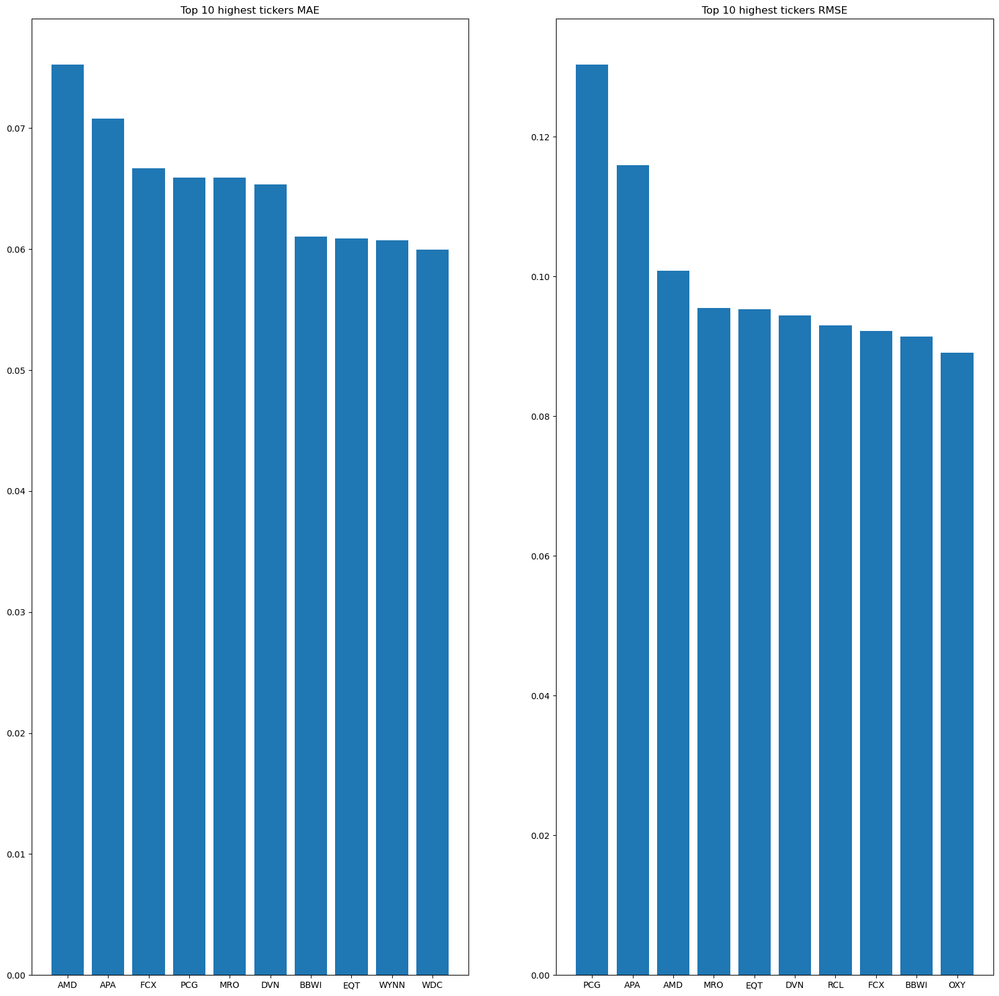

In [52]:
fig, ax = plt.subplots(1, 2, figsize=(20,20))
ax[0].bar(mae_df.sort_values(ascending=False).head(10).index, mae_df.sort_values(ascending=False).head(10))
ax[0].set_title('Top 10 highest tickers MAE')
ax[1].bar(rmse_df.sort_values(ascending=False).head(10).index, rmse_df.sort_values(ascending=False).head(10))
ax[1].set_title('Top 10 highest tickers RMSE')

In [72]:
test_strategies = strategy_return(test_preds)
test_strategies

,avg return,strategy,cumstrategy
Date,,,
2016-01-04,1.0,0.0,1.000000
2016-01-05,1.0,0.0,1.000000
2016-01-06,1.0,0.0,1.000000
2016-01-07,1.0,0.0,1.000000
2016-01-08,1.0,0.0,1.000000
...,...,...,...
2020-12-24,1.0,0.0,2.502396
2020-12-28,1.0,0.0,2.502396
2020-12-29,1.0,0.0,2.502396


In [73]:
def plot_returns(benchmark, strategy, title):
    plt.figure(figsize=(20, 12))
    plt.plot(pd.to_datetime(strategy.index).date, strategy.cumstrategy, label='Model')
    plt.plot(benchmark.index, benchmark['cumreturn'], color='red', label='SP500 Buy & Hold')
    plt.title(title)
    plt.gca().grid(True)
    plt.legend()

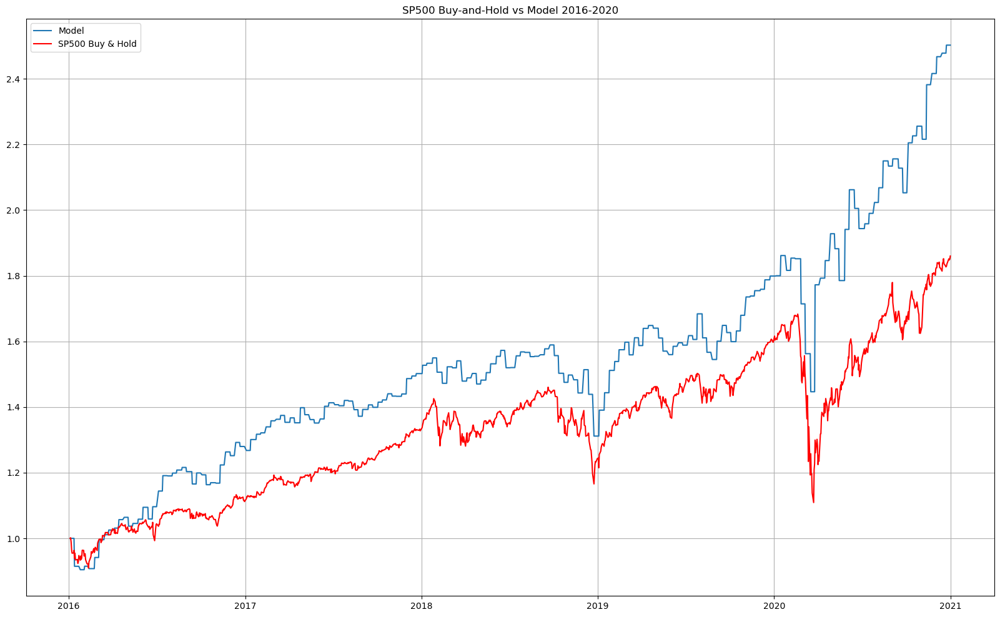

In [77]:
plot_returns(sp500, test_strategies, 'SP500 Buy-and-Hold vs Model 2016-2020')

In [79]:
sp500_weekly = sp500.copy()
sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-6)
sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)
sp500_weekly_return = []
for i in range(len(sp500_weekly)):
    if i%period == 0:
        sp500_weekly_return.append(sp500_weekly.iloc[i]['Target'])
    else:
        sp500_weekly_return.append(0)
temp_df = pd.DataFrame({'return': sp500_weekly_return}).shift(7)
temp_df =  temp_df.loc[temp_df['return'] != 0, 'return'].dropna()
sp500_sharpe = temp_df.mean()/temp_df.std()
sp500_sharpe

0.16723321200780666

In [80]:
strategy_weekly_return = test_strategies.loc[test_strategies['avg return'] != 1, 'avg return'] - 1
strategy_sharpe = strategy_weekly_return.mean()/strategy_weekly_return.std()
strategy_sharpe

0.1747563776143978